# Import the libary

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
#get the data
df = pd.read_csv("train_data.csv")
df = df.iloc[:,:-1]

In [3]:
df

,X,Y,B1,B2,B3,B4,B5,B6,B7,label
0,531648.191611,2.337715e+06,0.12015,0.14770,0.18155,0.19355,0.22010,0.24050,0.25095,1
1,595356.681101,2.293169e+06,0.07500,0.09530,0.12090,0.13180,0.16070,0.19300,0.20330,1
2,589384.010211,2.348416e+06,0.06235,0.06480,0.09735,0.08255,0.13425,0.20620,0.22980,1
3,569226.245959,2.317308e+06,0.05370,0.06315,0.09405,0.08390,0.13100,0.19540,0.21605,1
4,580176.142590,2.333484e+06,0.08990,0.07250,0.10485,0.09245,0.12330,0.19820,0.21810,1
...,...,...,...,...,...,...,...,...,...,...
6995,582167.032886,2.359614e+06,0.03185,0.03270,0.05150,0.03170,0.07480,0.20595,0.25560,10
6996,580425.003877,2.357375e+06,0.03315,0.03680,0.05860,0.04495,0.09390,0.21470,0.25640,10
6997,548073.036558,2.333235e+06,0.04775,0.04565,0.07045,0.06625,0.10640,0.20595,0.23580,10
6998,537372.001214,2.333235e+06,0.03075,0.03065,0.05205,0.02965,0.08190,0.26355,0.33015,10


# Data preprocessing

In [4]:
df.shape

(7000, 10)

In [5]:
#data information
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7000 entries, 0 to 6999
Data columns (total 10 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   X       7000 non-null   float64
 1   Y       7000 non-null   float64
 2   B1      7000 non-null   float64
 3   B2      7000 non-null   float64
 4   B3      7000 non-null   float64
 5   B4      7000 non-null   float64
 6   B5      7000 non-null   float64
 7   B6      7000 non-null   float64
 8   B7      7000 non-null   float64
 9   label   7000 non-null   int64  
dtypes: float64(9), int64(1)
memory usage: 547.0 KB


In [6]:
df.describe()

,X,Y,B1,B2,B3,B4,B5,B6,B7,label
count,7000.000000,7.000000e+03,7000.000000,7000.000000,7000.000000,7000.000000,7000.000000,7000.000000,7000.000000,7000.000000
mean,567556.208965,2.321500e+06,0.051640,0.057205,0.083395,0.071999,0.117732,0.214807,0.247513,4.857143
std,19606.272188,2.028273e+04,0.018751,0.021756,0.023265,0.031916,0.025211,0.050714,0.066122,3.044114
min,529906.162602,2.274255e+06,0.015400,0.020500,0.038100,0.018800,0.031700,0.018800,0.018700,1.000000
25%,549068.481706,2.308847e+06,0.037200,0.039838,0.066000,0.046300,0.099000,0.187488,0.207888,2.000000
50%,571217.136255,2.325023e+06,0.050700,0.056300,0.083600,0.071800,0.119250,0.219500,0.251150,4.000000
75%,583411.339322,2.334728e+06,0.063000,0.070163,0.095950,0.093413,0.133800,0.247713,0.291700,8.000000
max,605062.271297,2.364841e+06,0.229350,0.223850,0.258050,0.262000,0.281000,0.374500,0.495000,10.000000


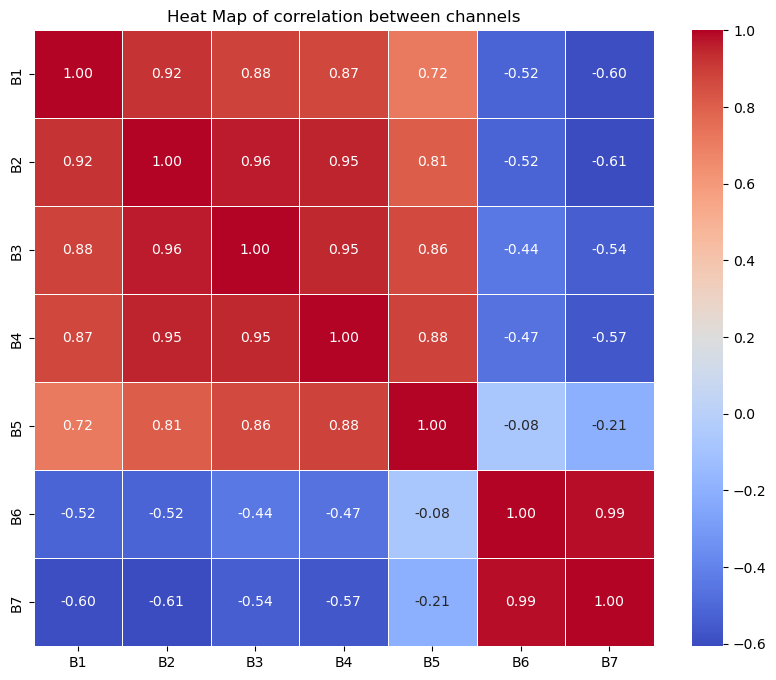

In [10]:
# Tạo bảng tương quan
correlation_matrix = df[['B1','B2','B3','B4','B5','B6','B7']].corr()

# Vẽ heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5)
plt.title('Heat Map of correlation between channels')
plt.show()


In [11]:
import numpy as np
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score, classification_report
from sklearn.ensemble import RandomForestClassifier

# Tạo dữ liệu
X, y = make_classification(n_samples=1000, n_features=8, n_informative=8, n_redundant=0, random_state=42)

# Chia thành tập huấn luyện và tập kiểm thử
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Huấn luyện mô hình
model = RandomForestClassifier(random_state=42)
model.fit(X_train, y_train)

# Dự đoán trên tập kiểm thử
y_pred = model.predict(X_test)

# Tính toán F1-score
f1 = f1_score(y_test, y_pred)

# In báo cáo phân loại
print("F1-score:", f1)
print("\nClassification Report:\n", classification_report(y_test, y_pred))


F1-score: 0.888888888888889

Classification Report:
               precision    recall  f1-score   support

           0       0.87      0.89      0.88        95
           1       0.90      0.88      0.89       105

    accuracy                           0.89       200
   macro avg       0.88      0.89      0.88       200
weighted avg       0.89      0.89      0.89       200



# Build Classification model



In [12]:
from sklearn import tree
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

In [13]:
X = df.iloc[:,2:9]
y = df.iloc[:,-1]

In [14]:
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size = 0.2,random_state= 42)

In [15]:
X_test

,B1,B2,B3,B4,B5,B6,B7
6500,0.05705,0.06020,0.08560,0.07715,0.13065,0.23910,0.27350
2944,0.05590,0.06500,0.08500,0.07600,0.11540,0.17070,0.17930
2024,0.05375,0.06220,0.09550,0.09195,0.14125,0.19535,0.21510
263,0.04105,0.04610,0.08050,0.05495,0.08415,0.15410,0.17155
4350,0.06290,0.07730,0.10485,0.09240,0.13745,0.23345,0.26250
...,...,...,...,...,...,...,...
3484,0.05050,0.06410,0.09500,0.09830,0.14155,0.23625,0.26050
1860,0.11210,0.08560,0.10820,0.10775,0.14480,0.20090,0.22405
4974,0.04205,0.04320,0.07500,0.05820,0.11275,0.25570,0.29685
387,0.07165,0.07670,0.09590,0.09755,0.12665,0.18180,0.20020


In [25]:
import xgboost as xgb
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)
X_train, X_test, y_train, y_test = train_test_split(X, y_encoded, test_size=0.2, random_state=42)
model = xgb.XGBClassifier(
    max_depth=3,
    learning_rate=0.1,
    n_estimators=100,
    objective='multi:softmax',  # Sử dụng 'multi:softmax' cho bài toán phân loại nhiều lớp
    eval_metric='mlogloss'      # Đánh giá mô hình với log loss cho bài toán nhiều lớp
)

model.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric='mlogloss',
              feature_types=None, gamma=None, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=0.1, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=3,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=100,
              n_jobs=None, num_parallel_tree=None, objective='multi:softmax', ...)

In [28]:
from sklearn.metrics import accuracy_score
# Dự đoán và đánh giá mô hình
y_pred = model.predict(X_test)

# Chuyển đổi lại nhãn về dạng gốc trước khi đánh giá
y_test_original = label_encoder.inverse_transform(y_test)
y_pred_original = label_encoder.inverse_transform(y_pred)

accuracy = accuracy_score(y_test_original, y_pred_original)
print(f"Accuracy: {accuracy}")

Accuracy: 0.5421428571428571


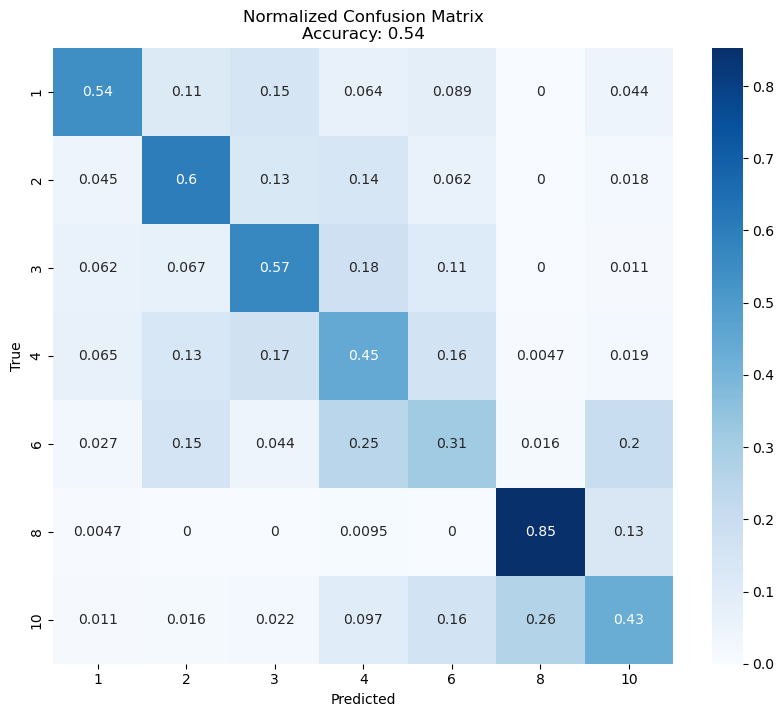

In [31]:
# Chuyển đổi lại nhãn về dạng gốc trước khi đánh giá
y_test_original = label_encoder.inverse_transform(y_test)
y_pred_original = label_encoder.inverse_transform(y_pred)

# Tính ma trận nhầm lẫn
cm = confusion_matrix(y_test_original, y_pred_original)

# Chuẩn hóa ma trận bằng cách chia mỗi giá trị cho tổng số lượng thực tế của từng lớp
cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

# Tính độ chính xác
accuracy = accuracy_score(y_test_original, y_pred_original)

# Vẽ ma trận nhầm lẫn chuẩn hóa với heatmap và số liệu
plt.figure(figsize=(10, 8))
sns.heatmap(cm_normalized, annot=True, cmap='Blues', xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
plt.title(f'Normalized Confusion Matrix\nAccuracy: {accuracy:.2f}')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

In [11]:
clf = tree.DecisionTreeClassifier(criterion='gini')
clf.fit(X_train,y_train)

DecisionTreeClassifier()

In [12]:
y_pred = clf.predict(X_test)


In [13]:
from sklearn.metrics import accuracy_score
accuracy = accuracy_score(y_test, y_pred)
accuracy

0.41714285714285715

# Classification assesment

In [14]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test,y_pred)
cm = cm.astype(float)

In [15]:
cm

array([[103.,  28.,  27.,   8.,  27.,   0.,  10.],
       [ 30.,  95.,  23.,  37.,  31.,   0.,   8.],
       [ 33.,  17.,  71.,  30.,  22.,   0.,   5.],
       [ 18.,  33.,  36.,  56.,  47.,   2.,  23.],
       [ 17.,  31.,  17.,  38.,  44.,   2.,  34.],
       [  1.,   0.,   0.,   0.,   6., 153.,  51.],
       [  8.,   7.,  16.,  13.,  35.,  45.,  62.]])

In [16]:
row_sum = []
for i in cm:
    row_sum.append(np.sum(i))

row_sum

        
        
# cf_df = pd.DataFrame(cm, columns =  np.unique(y_test),index =  np.unique(y_test))
# cf_df

[203.0, 224.0, 178.0, 215.0, 183.0, 211.0, 186.0]

In [17]:
for i in range(len(cm)):
    for j in range(len(cm[i])):
        cm[i][j] *=1.0
        cm[i][j]/=row_sum[i]

In [18]:
cf_df = pd.DataFrame(cm, columns =  np.unique(y_test),index =  np.unique(y_test))
cf_df

,1,2,3,4,6,8,10
1,0.507389,0.137931,0.133005,0.039409,0.133005,0.000000,0.049261
2,0.133929,0.424107,0.102679,0.165179,0.138393,0.000000,0.035714
3,0.185393,0.095506,0.398876,0.168539,0.123596,0.000000,0.028090
4,0.083721,0.153488,0.167442,0.260465,0.218605,0.009302,0.106977
6,0.092896,0.169399,0.092896,0.207650,0.240437,0.010929,0.185792
8,0.004739,0.000000,0.000000,0.000000,0.028436,0.725118,0.241706
10,0.043011,0.037634,0.086022,0.069892,0.188172,0.241935,0.333333


In [19]:
from sklearn.metrics import precision_score, recall_score, f1_score

# Tính precision
precision = precision_score(y_test, y_pred,average='macro')

# Tính recall
recall = recall_score(y_test, y_pred,average='macro')

# Tính f1-score
f1 = f1_score(y_test, y_pred,average='macro')

print("Precision:", precision)
print("Recall:", recall)
print("F1-Score:", f1)


Precision: 0.41547230160301407
Recall: 0.4128181144868246
F1-Score: 0.4134911539512744


In [20]:
unique_classes = np.unique(y_test)

# Tính precision, recall và f1-score cho từng lớp
for class_label in unique_classes:
    precision = precision_score(y_test == class_label, y_pred == class_label)
    recall = recall_score(y_test == class_label, y_pred == class_label)
    f1 = f1_score(y_test == class_label, y_pred == class_label)
    
    print(f"Class {class_label} - Precision: {precision:.2f}, Recall: {recall:.2f}, F1-Score: {f1:.2f}")


Class 1 - Precision: 0.49, Recall: 0.51, F1-Score: 0.50
Class 2 - Precision: 0.45, Recall: 0.42, F1-Score: 0.44
Class 3 - Precision: 0.37, Recall: 0.40, F1-Score: 0.39
Class 4 - Precision: 0.31, Recall: 0.26, F1-Score: 0.28
Class 6 - Precision: 0.21, Recall: 0.24, F1-Score: 0.22
Class 8 - Precision: 0.76, Recall: 0.73, F1-Score: 0.74
Class 10 - Precision: 0.32, Recall: 0.33, F1-Score: 0.33


In [21]:
from sklearn.ensemble import RandomForestClassifier

Rclf = RandomForestClassifier(criterion='gini', random_state=0)

In [22]:
Rclf.fit(X_train,y_train)

RandomForestClassifier(random_state=0)

In [23]:
accuracy = accuracy_score(y_test, y_pred)
accuracy

0.41714285714285715

# finetune the model

# grid search


In [24]:
from sklearn.model_selection import GridSearchCV

In [25]:
param_grid = {
    'criterion':['gini','entropy'],
    'max_depth': [None, 10, 20,30,40],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'min_impurity_decrease':[0,0.1,0.2]
}

In [26]:
grid_search = GridSearchCV(clf, param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [None, 10, 20, 30, 40],
                         'min_impurity_decrease': [0, 0.1, 0.2],
                         'min_samples_leaf': [1, 2, 4],
                         'min_samples_split': [2, 5, 10]},
             scoring='accuracy')

In [27]:
best_params = grid_search.best_params_
best_score = grid_search.best_score_
best_score

0.45946428571428566

In [28]:
grid_search.best_params_

{'criterion': 'gini',
 'max_depth': 10,
 'min_impurity_decrease': 0,
 'min_samples_leaf': 2,
 'min_samples_split': 2}

# SVM


In [29]:
from sklearn.svm import SVC

In [30]:
svm_classifier = SVC()  

svm_classifier.fit(X_train, y_train)



SVC()

In [31]:
y_pred = svm_classifier.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.5414285714285715


In [32]:
precision = precision_score(y_test, y_pred,average='macro')

# Tính recall
recall = recall_score(y_test, y_pred,average='macro')

# Tính f1-score
f1 = f1_score(y_test, y_pred,average='macro')

print("Precision:", precision)
print("Recall:", recall)
print("F1-Score:", f1)


Precision: 0.5453850465952533
Recall: 0.5368804584830439
F1-Score: 0.5364519762788305


In [33]:
from sklearn.neural_network import MLPClassifier

mlp = MLPClassifier(hidden_layer_sizes=(100, 50), activation='relu', max_iter=1000)

mlp.fit(X_train, y_train)

accuracy = mlp.score(X_test, y_test)
accuracy


0.5435714285714286

# Gen map


In [121]:
from osgeo import gdal
import struct
#load data from file .tif
data_band = gdal.Open("HaNoiResample.tif",gdal.GA_ReadOnly)
data_band

<osgeo.gdal.Dataset; proxy of <Swig Object of type 'GDALDatasetShadow *' at 0x000002746112AF10> >

In [175]:
layer_band = np.zeros((367,308,7))


In [172]:
class_band = data_band.GetRasterBand(1)
bandData = class_band.ReadRaster(xoff=7, yoff=110,
                                            xsize=1, ysize=1,
                                            buf_xsize=1, buf_ysize=1,
                                            buf_type=gdal.GDT_Float32)
decimal_value =struct.unpack('f', bandData)[0]
decimal_value


0.12014999985694885

In [233]:
#Load the cube of data_band
for y in range(367):
    for x in range(308):
        for band in range(1,8):
            class_band = data_band.GetRasterBand(band)
            bandData = class_band.ReadRaster(xoff=x, yoff=y,
                                            xsize=1, ysize=1,
                                            buf_xsize=1, buf_ysize=1,
                                            buf_type=gdal.GDT_Float32)

            decimal_value =struct.unpack('f', bandData)[0]
            layer_band[y,x,band-1] = decimal_value


D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = in

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = in

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = in

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = in

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = in

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = in

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = in

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = in

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(
C:\Users\Admin\AppData\Local\Temp\ipykernel_16008\3346103477.py:35: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))
D:\anaconda\envs\pygdal\Lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but S

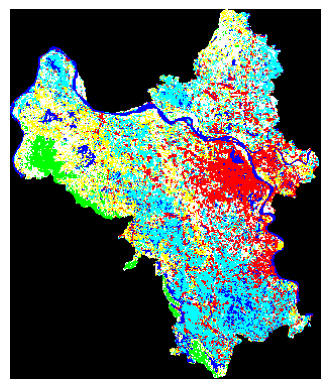

In [241]:
import matplotlib.pyplot as plt
import numpy as np

# Danh sách màu tương ứng với từng pixel (13 màu)
colors = [
    (0, 0, 0),   
    ( 0,0,100),   
    (255,0,0),
    (0,128,255),
    (255,193,191),
    (255,255,0),
    (128,255,0),
    (186,186,186),
    (0,100,0),
    (171,218,157),
    (229,99,208),
    (128,100,0),
    (77,104,255)
]

#kích thước ảnh
width = 308
height = 367

# Tạo hình ảnh từ danh sách màu
image = np.zeros((height, width, 3)) 

# Điền màu sắc cho từng pixel dựa trên danh sách màu
for y in range(height):
    for x in range(width):
        color_index = 0
        if (([tmp[y,x,:]]) == np.zeros((7))).any():
            color_index= 0
        else:
            color_index = int(svm_classifier.predict(np.array([tmp[y,x,:]])))  
        image[y, x, :] = (colors[color_index])
# Hiển thị hình ảnh
plt.imshow(image)
plt.axis('off')  # Tắt trục
plt.show()


In [234]:
for y in range(height):
    for x in range(width):
        if(layer_band[y,x,:] == np.empty(7)).all():
            print(y,x)


0 0
0 1
0 2
0 3
0 4
0 5
0 6
0 7
0 8
0 9
0 10
0 11
0 12
0 13
0 14
0 15
0 16
0 17
0 18
0 19
0 20
0 21
0 22
0 23
0 24
0 25
0 26
0 27
0 28
0 29
0 30
0 31
0 32
0 33
0 34
0 35
0 36
0 37
0 38
0 39
0 40
0 41
0 42
0 43
0 44
0 45
0 46
0 47
0 48
0 49
0 50
0 51
0 52
0 53
0 54
0 55
0 56
0 57
0 58
0 59
0 60
0 61
0 62
0 63
0 64
0 65
0 66
0 67
0 68
0 69
0 70
0 71
0 72
0 73
0 74
0 75
0 76
0 77
0 78
0 79
0 80
0 81
0 82
0 83
0 84
0 85
0 86
0 87
0 88
0 89
0 90
0 91
0 92
0 93
0 94
0 95
0 96
0 97
0 98
0 99
0 100
0 101
0 102
0 103
0 104
0 105
0 106
0 107
0 108
0 109
0 110
0 111
0 112
0 113
0 114
0 115
0 116
0 117
0 118
0 119
0 120
0 121
0 122
0 123
0 124
0 125
0 126
0 127
0 128
0 129
0 130
0 131
0 132
0 133
0 134
0 135
0 136
0 137
0 138
0 139
0 140
0 141
0 142
0 143
0 144
0 145
0 146
0 147
0 148
0 149
0 150
0 151
0 152
0 153
0 154
0 155
0 156
0 157
0 158
0 159
0 160
0 161
0 162
0 163
0 164
0 165
0 166
0 167
0 168
0 169
0 170
0 171
0 172
0 173
0 174
0 175
0 176
0 177
0 178
0 179
0 180
0 181
0 182
0 183
0 184


In [239]:
tmp = np.nan_to_num(layer_band)
